In [1]:
#importing libraries
import numpy as np
import pandas as pd
# Set display options to show all rows and columns without truncation
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

**DATA EXPLORATION**

In [2]:
#our data is separated by ::: there's also \n for new lines
df_train = pd.read_csv('train_data.txt',sep=' ::: ',header=None,engine='python', names=['Title','Genre','Description'])
df_train

,Title,Genre,Description
1,Oscar et la dame rose (2009),drama,Listening in to a conversation between his doc...
2,Cupid (1997),thriller,A brother and sister with a past incestuous re...
3,"Young, Wild and Wonderful (1980)",adult,As the bus empties the students for their fiel...
4,The Secret Sin (1915),drama,To help their unemployed father make ends meet...
5,The Unrecovered (2007),drama,The film's title refers not only to the un-rec...
6,Quality Control (2011),documentary,Quality Control consists of a series of 16mm s...
7,"""Pink Slip"" (2009)",comedy,In tough economic times Max and Joey have all ...
8,One Step Away (1985),crime,Ron Petrie (Keanu Reeves) is a troubled teen w...
9,"""Desperate Hours"" (2016)",reality-tv,"A sudden calamitous event, causing great loss ..."
10,Spirits (2014/I),horror,Four high school students embark on a terrifyi...


In [3]:
df_train.describe()

,Title,Genre,Description
count,54214,54214,54214
unique,54214,27,54086
top,Oscar et la dame rose (2009),drama,Grammy - music award of the American academy o...
freq,1,13613,12


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 54214 entries, 1 to 54214
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Title        54214 non-null  object
 1   Genre        54214 non-null  object
 2   Description  54214 non-null  object
dtypes: object(3)
memory usage: 1.7+ MB


In [5]:
df_train.isnull().sum()

Title          0
Genre          0
Description    0
dtype: int64

In [6]:
df_train.duplicated().sum()

0

In [7]:
df_test = pd.read_csv('test_data.txt', sep=':::', names=['Id', 'Title', 'Description'], engine='python')
df_test.head()

,Id,Title,Description
0,1,Edgar's Lunch (1998),"L.R. Brane loves his life - his car, his apar..."
1,2,La guerra de papá (1977),"Spain, March 1964: Quico is a very naughty ch..."
2,3,Off the Beaten Track (2010),One year in the life of Albin and his family ...
3,4,Meu Amigo Hindu (2015),"His father has died, he hasn't spoken with hi..."
4,5,Er nu zhai (1955),Before he was known internationally as a mart...


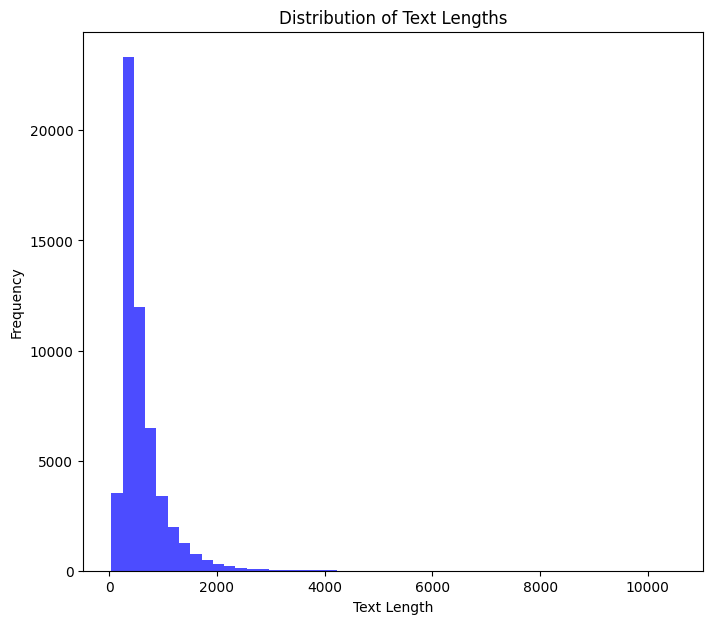

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

# Drop rows with missing values in the 'Description' column, if present
df_train = df_train.dropna(subset=['Description'])

# Calculate the length of cleaned text
df_train['length_Description'] = df_train['Description'].apply(len)

# Visualize the distribution of text lengths
plt.figure(figsize=(8, 7))
plt.hist(df_train['length_Description'], bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Text Lengths')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.show()

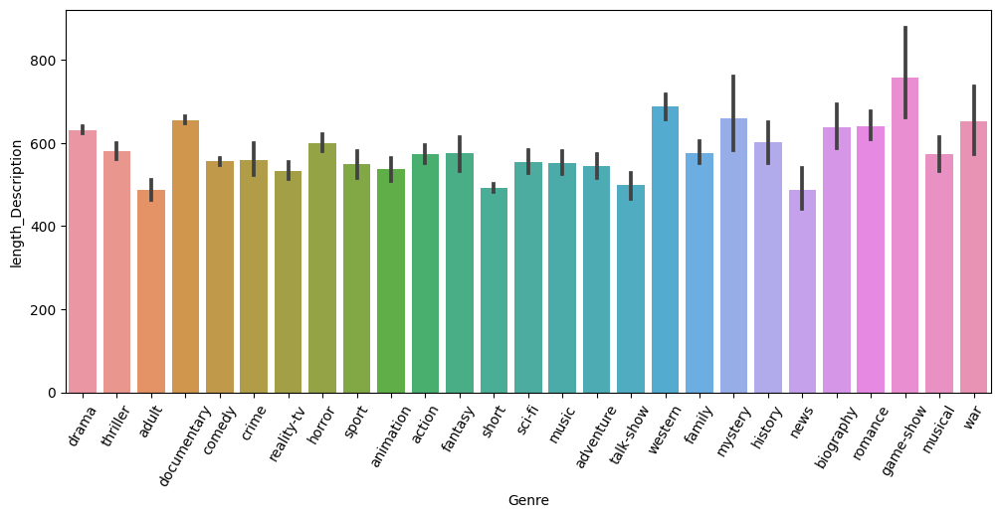

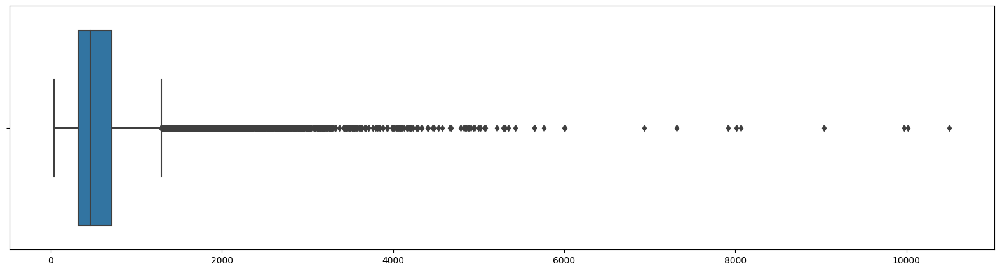

In [9]:

plt.figure(figsize=(12,5))
sns.barplot(x='Genre',y='length_Description',data=df_train)  # from 600ish to 350ish -> significant reduction in length
plt.xticks(rotation=60)
plt.show()
plt.figure(figsize=(20,5))
sns.boxplot(x=df_train['length_Description'].values,hue='Genre',data=df_train)
plt.show()

**DATA CLEANING AND TOKENIZATION USING NLP**

In [10]:
import re
import string
import nltk
# Ensure you have downloaded the stopwords dataset
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [11]:
df_train['Genre'].values

array(['drama', 'thriller', 'adult', ..., 'documentary', 'comedy',
       'history'], dtype=object)

In [12]:
# Define the clean_text function
def clean_text(text):
    # Convert to lowercase
    text = text.lower()

    # Remove URLs, Twitter handles, and pic. links
    text = re.sub(r'http\S+|@\S+|pic.\S+', '', text)

    # Keep only alphabetical characters, single quotes, and spaces
    text = re.sub(r"[^a-zA-Z+' ]", ' ', text)

    # Tokenize the text
    words = word_tokenize(text)

    # Remove stopwords and words with length <= 2
    stop_words = set(stopwords.words('english'))
    words = [word for word in words if word not in stop_words and len(word) > 2]

    # Join the words into a cleaned text
    cleaned_text = ' '.join(words)

    return cleaned_text

We Remove URLs, Twitter handles, and pic. links Convert text into lowercase, Replace multiple spaces with a single space and done tokenization and then we applied this to text content
column

In [13]:
# Apply the clean_text function to the 'Description' column in the training and test data
df_train['Text_cleaning'] = df_train['Description'].apply(clean_text)
df_test['Text_cleaning'] = df_test['Description'].apply(clean_text)

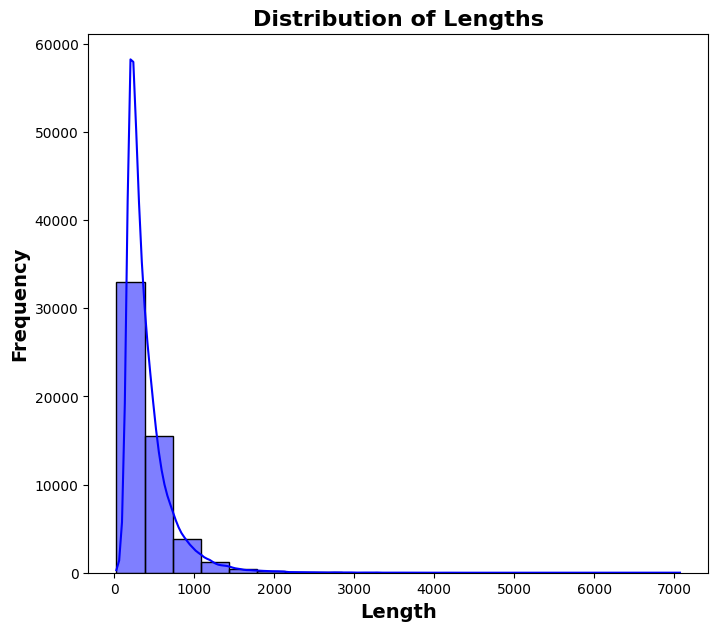

In [14]:
# Calculate the length of cleaned text
df_train['length_Text_cleaning'] = df_train['Text_cleaning'].apply(len)
# Visualize the distribution of text lengths
plt.figure(figsize=(8, 7))
sns.histplot(data=df_train, x='length_Text_cleaning', bins=20, kde=True, color='blue')
plt.xlabel('Length', fontsize=14, fontweight='bold')
plt.ylabel('Frequency', fontsize=14, fontweight='bold')
plt.title('Distribution of Lengths', fontsize=16, fontweight='bold')
plt.show()

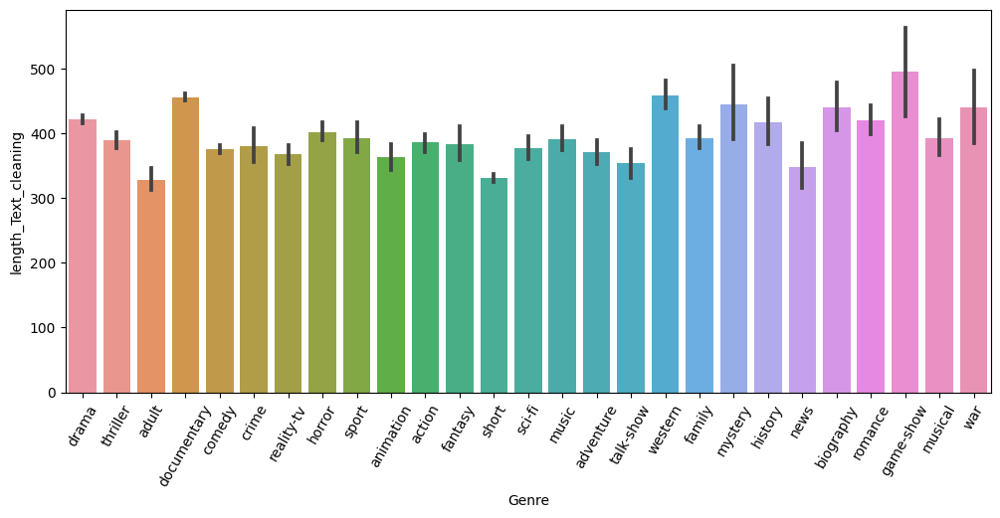

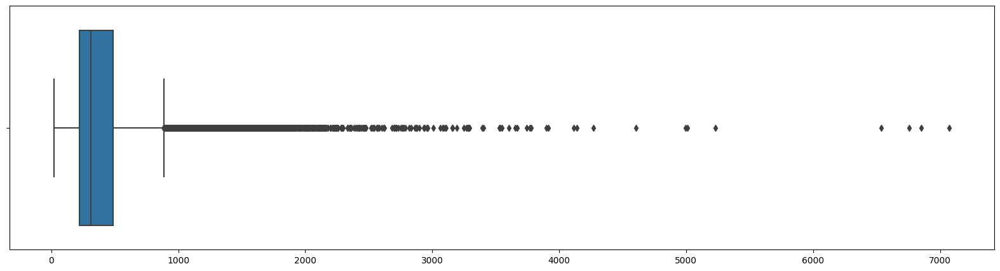

In [15]:
plt.figure(figsize=(12,5))
sns.barplot(x='Genre',y='length_Text_cleaning',data=df_train)  # from 600ish to 350ish -> significant reduction in length
plt.xticks(rotation=60)
plt.show()
plt.figure(figsize=(20,5))
sns.boxplot(x=df_train['length_Text_cleaning'].values,hue='Genre',data=df_train)
plt.show()

Text(0.5, 1.0, 'Distribution of Genre')

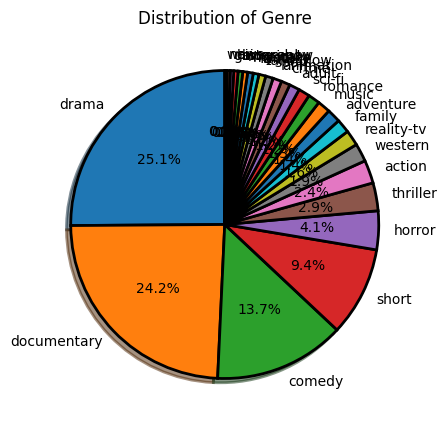

In [16]:
# Visualization of Categorical data (Intensity)
fig = plt.figure(figsize=(5,5))
wp = {'linewidth':2, 'edgecolor':"black"}
tags = df_train['Genre'].value_counts()
tags.plot(kind='pie', autopct='%1.1f%%', shadow=True, startangle=90, wedgeprops = wp, label='')
plt.title('Distribution of Genre')

We observed that Genre distribution is imbalanced we need to deal with it.
Here one class has significantly fewer instances than the other, so we choose undersampling technique to balance this.

**FEATURE ENGINEERING & FEATURE SELECTION**

In [17]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report

In [18]:
# Split the data into training and validation sets
X = df_train['Text_cleaning']
y = df_train['Genre']

**DEALING WITH IMBALANCED DATASET USING UNDERSAMPLING**

In [19]:
from imblearn.under_sampling import RandomUnderSampler
#Define the Undersampling
undersampler = RandomUnderSampler(sampling_strategy='auto', random_state=42)

#Reshape X to a 1D array (necessary for undersampling)
X_reshaped = X.values.reshape(-1, 1)

#fit the Undersample in X & y
X_resampled, y_resampled = undersampler.fit_resample(X_reshaped, y)

# Convert X back to a Series
X_resampled = pd.Series(X_resampled.flatten())

Text(0.5, 1.0, 'After resampling: Distribution of Intensity')

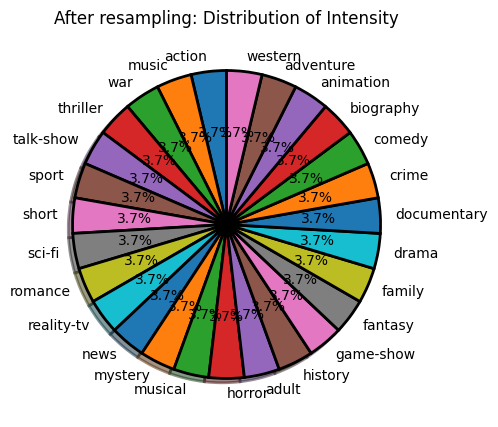

In [20]:
# Visualization of resampled Intensity levels
fig = plt.figure(figsize=(5,5))
wp = {'linewidth':2, 'edgecolor':"black"}
tags = y_resampled.value_counts()
tags.plot(kind='pie', autopct='%1.1f%%', shadow=True, startangle=90, wedgeprops = wp, label='')
plt.title('After resampling: Distribution of Intensity')

As we see now Genre levels are equally distributed as 3.7% which means our Genre levels are balanced.

In [21]:
#TF-IDF Vectorization
tfidf_vectorizer = TfidfVectorizer(max_features=5000)

#Fit and transform on the undersampled data
X_tfidf = tfidf_vectorizer.fit_transform(X_resampled)

In [22]:
#Train-Test Split
X_train, X_val, y_train, y_val = train_test_split(X_tfidf, y_resampled, test_size=0.2, random_state=42)

In [23]:
#Print the shape of X, y train & test dataset
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((2851, 5000), (713, 5000), (2851,), (713,))

**MODEL DEVELOPMENT AND EVALUATION**

In [24]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV, StratifiedKFold

In [25]:
#Define Machine Learning Models
models = {
      'Logistic Regression' :LogisticRegression(),
      'SVM': SVC(),
      'Naive Bayes': MultinomialNB()
}

**HYPERPARAMETER TUNING & CROSS VALIDATION FOR MODEL IMPROVEMENT**

In [26]:
#Define Hyperparameter using GridSearchCV
hyperparameters = {
    'Logistic Regression' : {'C': [0.001, 0.01, 0.1, 1, 10, 100]},
    'SVM': {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']},
    'Naive Bayes': {'alpha': [0.1, 0.5, 1.0]}
}

In [27]:
#define cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

In [28]:
# Create an empty list to store results
results_list = []

# Variables to track the best model and its accuracy
best_model_name = None
best_val_accuracy = 0.0
min_accuracy_difference = float('inf')  # Initialize with a large value

# Train and Evaluate Models
for models_name, model in models.items():
    print(f"\nTraining and evaluating {models_name}...")

    # Apply Hyperparameter tuning & cross-validation
    grid_search = GridSearchCV(model, hyperparameters[models_name], cv=cv, scoring='accuracy')
    grid_search.fit(X_train, y_train)

    # Best hyperparameters
    best_params = grid_search.best_params_
    print(f"Best Hyperparameters for {models_name}: {best_params}")

    # Updated model with best hyperparameters
    best_model = grid_search.best_estimator_

    # Training Accuracy
    train_predictions = best_model.predict(X_train)
    train_accuracy = accuracy_score(y_train, train_predictions)
    print(f"{models_name} Training Accuracy: {train_accuracy:.3f}")

    # Val Accuracy
    val_predictions = best_model.predict(X_val)
    val_accuracy = accuracy_score(y_val, val_predictions)
    print(f"{models_name} Val Accuracy: {val_accuracy:.3f}")

    # Display classification report for the test set
    print(f"Classification Report for {models_name} (val Set):")
    print(classification_report(y_val, val_predictions))

    # Calculate the absolute difference between training and test accuracy
    accuracy_difference = abs(train_accuracy - val_accuracy)

    # Save the model with the least difference between training and test accuracy
    if accuracy_difference < min_accuracy_difference:
        min_accuracy_difference = accuracy_difference
        best_model_name = models_name
        best_val_accuracy = val_accuracy

    # Append results to the list
    results_list.append({
        'Model Name': models_name,
        'Training Accuracy': train_accuracy,
        'Vailidation Accuracy': val_accuracy,
        'Accuracy Difference': accuracy_difference,
        'Best Hyperparameters': best_params,
        'Model': best_model
    })


Training and evaluating Logistic Regression...


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

Best Hyperparameters for Logistic Regression: {'C': 1}
Logistic Regression Training Accuracy: 0.940
Logistic Regression Val Accuracy: 0.405
Classification Report for Logistic Regression (val Set):
              precision    recall  f1-score   support

      action       0.26      0.18      0.21        28
       adult       0.67      0.51      0.58        39
   adventure       0.33      0.19      0.24        32
   animation       0.50      0.12      0.20        33
   biography       0.26      0.31      0.28        26
      comedy       0.30      0.24      0.27        25
       crime       0.45      0.54      0.49        24
 documentary       0.39      0.22      0.28        32
       drama       0.29      0.23      0.26        26
      family       0.23      0.40      0.29        20
     fantasy       0.37      0.38      0.38        26
   game-show       0.90      0.67      0.77        27
     history       0.38      0.46      0.42        24
      horror       0.46      0.43      0.45   

We trained all 3 selected machine learning models (Logistic Regression,SVM and Naïve Baye) using best Hyperparameter and Cross validation methods.

**Model Evaluation:**

In [29]:
# Convert the list to a DataFrame
results_df = pd.DataFrame(results_list)

# Sort the DataFrame by training & testing accuracy in descending order
results_df_sorted = results_df.sort_values(by=['Training Accuracy', 'Vailidation Accuracy'], ascending=False)

# Display the Model comparison matrix
print("Model Comparison Matrix:")
results_df_sorted

Model Comparison Matrix:


,Model Name,Training Accuracy,Vailidation Accuracy,Accuracy Difference,Best Hyperparameters,Model
1,SVM,1.000000,0.396914,0.603086,"{'C': 10, 'kernel': 'rbf'}",SVC(C=10)
2,Naive Bayes,0.973693,0.399719,0.573974,{'alpha': 0.5},MultinomialNB(alpha=0.5)
0,Logistic Regression,0.939670,0.405330,0.534341,{'C': 1},LogisticRegression(C=1)


We can observe clearly from our model comparison matrix that, the model with the highest test accuracy is Logistic Regression with 40.53%. However, it's crucial to consider the accuracy difference as well to identify potential overfitting. A lower accuracy difference suggests better generalization to unseen data.
In this case, the Logistic Regression model has a relatively good test accuracy (40.53%) and a lower accuracy difference (53.43%) compared to other models. Therefore, considering both accuracy and the accuracy difference, the Logistic Regression model appears to be a reasonable choice.

**SAVING THE MODEL**

In [30]:
import joblib
# Save the best model based on the least difference between training and test accuracy
best_model = results_df.loc[results_df['Model Name'] == best_model_name, 'Model'].values[0]
best_model_path = f'{best_model_name}_best_model.pkl'
joblib.dump(best_model, best_model_path)
print(f"\nBest Model ({best_model_name}) saved successfully at: {best_model_path}")

# Save the TF-IDF vectorizer
tfidf_vectorizer_path = 'genre_tfidf_vectorizer.pkl'
joblib.dump(tfidf_vectorizer, tfidf_vectorizer_path)
print(f"TF-IDF Vectorizer saved successfully at: {tfidf_vectorizer_path}")


Best Model (Logistic Regression) saved successfully at: Logistic Regression_best_model.pkl
TF-IDF Vectorizer saved successfully at: genre_tfidf_vectorizer.pkl


**TEST & VALIDATE THE MODEL**

In [31]:
# Load the saved model and TF-IDF vectorizer
loaded_model = joblib.load('Logistic Regression_best_model.pkl')
loaded_tfidf_vectorizer = joblib.load('genre_tfidf_vectorizer.pkl')

In [ ]:

# Extract the 'Description' column from the test dataset
test_sentences = df_test['Description'].tolist()

# Create an empty list to store predicted genres
predicted_genres = []

# Iterate through text contents in the test dataset and predict genre
for sentence in test_sentences:
    # Preprocess the new text
    cleaned_text = clean_text(sentence)
    preprocessed_text = clean_text(cleaned_text)

    # Transform the preprocessed text using the loaded TF-IDF vectorizer
    X_new = loaded_tfidf_vectorizer.transform([preprocessed_text])

    # Make predictions using the loaded model
    new_text_prediction = loaded_model.predict(X_new)

    # Append the predicted genre to the list
    predicted_genres.append(new_text_prediction[0])

# Add the predicted genres as a new column in the test dataset
df_test['Predicted Genre'] = predicted_genres
df_test

In [ ]:
# Assuming df_test is your DataFrame and predicted_genres is the list of predicted genres
df_test['Predicted Genre'] = predicted_genres

# Save the DataFrame to a text file (change 'output_file.txt' to your desired file name)
df_test.to_csv('output_file.txt', sep='\t', index=False)